## PBMC atlas

https://www.nature.com/articles/s41587-023-01881-x#data-availability

In [1]:
import time
from pathlib import Path
import concord as ccd
import scanpy as sc
proj_name = "pbmc_atac_scRNAmultiome"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)

data_dir = f"../data/human_pbmc_atac_benchmark/"
data_dir = Path(data_dir)

file_suffix = f"{time.strftime('%b%d-%H%M')}"
file_suffix

'Aug07-1215'

### Data loading and preprocessing

In [19]:
import os, re, glob, gzip, numpy as np, pandas as pd, scipy.io
from scipy.sparse import csr_matrix
import anndata as ad

triples   = sorted(glob.glob(os.path.join(data_dir, "*.matrix.mtx.gz")))
print(f"found {len(triples)} count matrices")

found 9 count matrices


In [ ]:
import os, re, glob, gzip, numpy as np, pandas as pd, scipy.io
from scipy.sparse import csr_matrix
import anndata as ad

DATA_DIR = data_dir + 'GSE194028_RAW_multiome_scRNA'
triples   = sorted(glob.glob(os.path.join(DATA_DIR, "*.matrix.mtx.gz")))
print(f"found {len(triples)} count matrices")

adatas = []

for mtx_path in triples:
    stem      = re.sub(r"\.matrix\.mtx\.gz$", "", os.path.basename(mtx_path))
    bc_path   = os.path.join(DATA_DIR, f"{stem}.barcodes.tsv.gz")
    feat_path = os.path.join(DATA_DIR, f"{stem}.features.tsv.gz")

    # ── barcodes ────────────────────────────────
    with gzip.open(bc_path, "rt") as f:
        barcodes = f.read().splitlines()

    # ── features & RNA mask ─────────────────────
    feat = pd.read_csv(feat_path, header=None, sep="\t")
    keep = feat.iloc[:, 2].eq("Gene Expression") if feat.shape[1] >= 3 else np.ones(len(feat), bool)
    feat = feat[keep].reset_index(drop=True)

    # ── matrix: transpose to cells × genes ──────
    mat  = scipy.io.mmread(mtx_path).tocsr()
    mat  = mat[keep.values, :].T.tocsr()

    # ── build AnnData (index = ENSEMBL ID) ────── 👈
    adata = ad.AnnData(
        X   = mat,
        obs = pd.DataFrame(index=barcodes),
        var = pd.DataFrame(
            {
                "gene_id":   feat.iloc[:, 0].values,
                "gene_name": feat.iloc[:, 1].values,
            },
            index = feat.iloc[:, 0].values,          # 👈 gene_id unique
        ),
    )
    adata.var_names_make_unique()                   # 👈 extra safety

    adata.obs["sample"] = stem.split("-outs")[0]
    adata.obs["batch"]  = re.sub(r"_\d+$", "", adata.obs["sample"].iloc[0].split("_",1)[-1])
    # Extract barcode
    adata.obs["cell"]   = adata.obs.index.str.split("-").str[0]
    # make new index by cell___sample
    adata.obs.index     = adata.obs["cell"] + "__" + adata.obs["sample"]

    # ── mild cell filter (≥50 UMIs) ──────────────
    keep_cells = np.ravel(adata.X.sum(axis=1)) > 50
    adata      = adata[keep_cells, :].copy()

    print(f"{adata.obs['sample'].iloc[0]:<40}  ->  {adata.shape[0]:>6,d} cells × {adata.shape[1]:>5,d} genes")
    adata.obs['sample'] = adata.obs['sample'].astype("str")
    adatas.append(adata)


found 9 count matrices
GSM7102992_CNA_10xmultiome_1              ->  30,463 cells × 36,601 genes
GSM7102993_CNA_10xmultiome_2              ->  30,142 cells × 36,601 genes
GSM7102994_SAN_10xmultiome_1              ->   8,925 cells × 36,601 genes
GSM7102995_SAN_10xmultiome_2              ->  14,406 cells × 36,601 genes
GSM7102996_VIB_10xmultiome_1              ->   8,912 cells × 36,601 genes
GSM7102997_VIB_10xmultiome_2              ->  28,099 cells × 36,601 genes
GSM7102998_CNA_10xscrna_1                 ->  22,641 cells × 36,601 genes
GSM7102999_CNA_10xscrna_2                 ->  49,638 cells × 36,601 genes
GSM7103000_CNA_10xscrna_3                 ->  53,505 cells × 36,601 genes


In [ ]:
# ── merge ───────────────────────────────────────
combined = ad.concat(
    adatas,
    join="outer",
    merge="same",
    index_unique=None,
    fill_value=0,
)

del combined.obs['cell']
# Save combined AnnData
combined.write_h5ad(DATA_DIR / f"{proj_name}_combined_{file_suffix}.h5ad")
print(f"Saved combined AnnData to {DATA_DIR / f'{proj_name}_combined_{file_suffix}.h5ad'}")

Saved combined AnnData to ../data/human_pbmc_atac_benchmark/GSE194028_RAW_multiome_scRNA/pbmc_atac_scRNAmultiome_combined_Jun19-1306.h5ad


## Run preliminary analysis

In [ ]:
adata = sc.read_h5ad(DATA_DIR / f"pbmc_atac_scRNAmultiome_combined_Jun19-1306.h5ad")

In [15]:
# Preprocessing
sc.pp.calculate_qc_metrics(adata, inplace=True)
adata.layers["counts"] = adata.X.copy()  # Store raw counts
# Normalize and log-transform
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)

In [16]:
adata.obs

,sample,batch,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes
AAACAGCCAAACCTAT__GSM7102992_CNA_10xmultiome_1,GSM7102992_CNA_10xmultiome_1,CNA_10xmultiome,3620,8.194506,11065,9.311633,18.409399,24.753728,33.791234,50.591957
AAACAGCCAAACTCAT__GSM7102992_CNA_10xmultiome_1,GSM7102992_CNA_10xmultiome_1,CNA_10xmultiome,62,4.143135,77,4.356709,84.415584,100.000000,100.000000,100.000000
AAACAGCCAAAGGTAC__GSM7102992_CNA_10xmultiome_1,GSM7102992_CNA_10xmultiome_1,CNA_10xmultiome,49,3.912023,55,4.025352,100.000000,100.000000,100.000000,100.000000
AAACAGCCAACCTAAT__GSM7102992_CNA_10xmultiome_1,GSM7102992_CNA_10xmultiome_1,CNA_10xmultiome,51,3.951244,52,3.970292,98.076923,100.000000,100.000000,100.000000
AAACAGCCAAGACTCC__GSM7102992_CNA_10xmultiome_1,GSM7102992_CNA_10xmultiome_1,CNA_10xmultiome,48,3.891820,55,4.025352,100.000000,100.000000,100.000000,100.000000
...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCGTTATCT__GSM7103000_CNA_10xscrna_3,GSM7103000_CNA_10xscrna_3,CNA_10xscrna,57,4.060443,59,4.094345,88.135593,100.000000,100.000000,100.000000
TTTGTTGTCTCCTGAC__GSM7103000_CNA_10xscrna_3,GSM7103000_CNA_10xscrna_3,CNA_10xscrna,53,3.988984,58,4.077537,94.827586,100.000000,100.000000,100.000000
TTTGTTGTCTCGCGTT__GSM7103000_CNA_10xscrna_3,GSM7103000_CNA_10xscrna_3,CNA_10xscrna,62,4.143135,70,4.262680,82.857143,100.000000,100.000000,100.000000
TTTGTTGTCTGCGGGT__GSM7103000_CNA_10xscrna_3,GSM7103000_CNA_10xscrna_3,CNA_10xscrna,44,3.806662,54,4.007333,100.000000,100.000000,100.000000,100.000000


In [17]:
# PCA and neighbors and UMAP
sc.pp.pca(adata, n_comps=50, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)
sc.tl.umap(adata)

In [19]:
# leiden
sc.tl.leiden(adata, resolution=0.5)

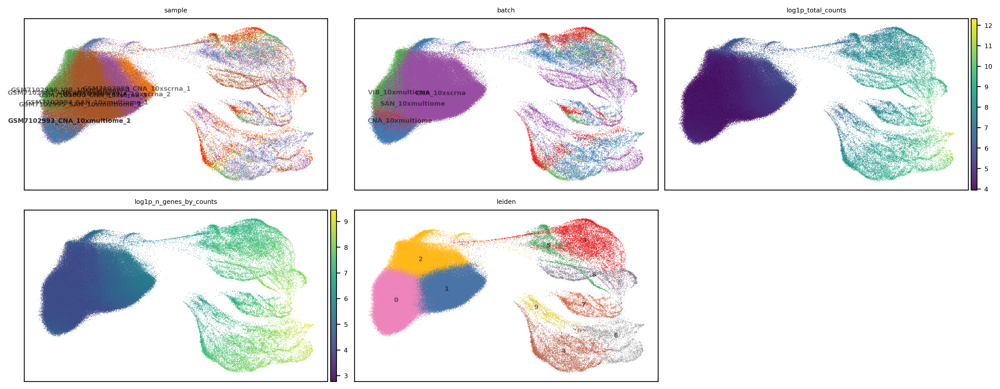

In [21]:
show_basis = f'X_umap'
show_cols = ['sample', 'batch', 'log1p_total_counts', 'log1p_n_genes_by_counts', 'leiden']   
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3,  font_size=6, point_size=1, legend_loc='on data',
    save_path=save_dir / f"scRNA_{show_basis}_{file_suffix}.png"
)

In [ ]:
# Save the processed AnnData object
adata.write_h5ad(save_dir / f"{proj_name}_processed_{file_suffix}.h5ad")
print(f"Saved processed AnnData to {save_dir / f'{proj_name}_processed_{file_suffix}.h5ad'}")

Saved processed AnnData to ../save/dev_pbmc_atac_scRNAmultiome-Jun19/pbmc_atac_scRNAmultiome_processed_Jun19-1410.h5ad


In [23]:
# Filter the adata to exclude cluster 0,1,2
filtered_adata = adata[~adata.obs['leiden'].isin(['0', '1', '2'])].copy()
filtered_adata.shape

(35658, 36601)

In [31]:
# Re-run PCA, UMAP and Leiden clustering on the filtered data
sc.pp.highly_variable_genes(filtered_adata, n_top_genes=5000, flavor='seurat_v3', subset=False)
sc.pp.pca(filtered_adata, n_comps=50, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(filtered_adata, n_neighbors=15, n_pcs=50)
sc.tl.umap(filtered_adata)
# Re-run Leiden clustering
sc.tl.leiden(filtered_adata, resolution=0.5)

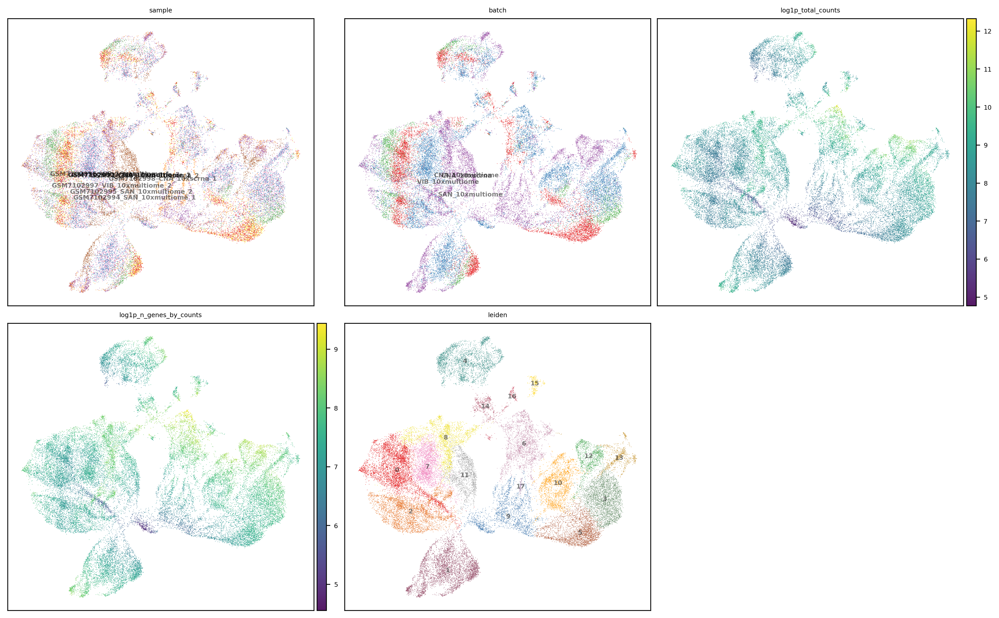

In [32]:
show_basis = f'X_umap'
show_cols = ['sample', 'batch', 'log1p_total_counts', 'log1p_n_genes_by_counts', 'leiden']   
ccd.pl.plot_embedding(
    filtered_adata, show_basis, show_cols, figsize=(13,8), dpi=300, ncols=3,  font_size=6, point_size=1, legend_loc='on data',
    save_path=save_dir / f"scRNA_{show_basis}_{file_suffix}.png"
)

In [ ]:
# Save filtered AnnData object
filtered_adata.write_h5ad(data_dir / f"{proj_name}_filtered_{file_suffix}.h5ad")
print(f"Saved filtered AnnData to {data_dir / f'{proj_name}_filtered_{file_suffix}.h5ad'}")

Saved filtered AnnData to ../data/human_pbmc_atac_benchmark/pbmc_atac_scRNAmultiome_filtered_Jun19-1448.h5ad


### CONCORD

In [2]:
adata = sc.read_h5ad(data_dir / f"pbmc_atac_scRNAmultiome_filtered_Jun19-1448.h5ad")

In [ ]:
import concord as ccd
n_latent = 50
hvg_list = adata.var_names[adata.var['highly_variable']].tolist()
cur_ccd = ccd.Concord(adata=adata, 
                      latent_dim = n_latent,
                      input_feature = hvg_list,
                      domain_key='sample', # key in adata.obs that contains domain labels
                      save_dir=save_dir, # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.fit_transform(output_key=output_key)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"adata_obsm_{file_suffix}.h5")

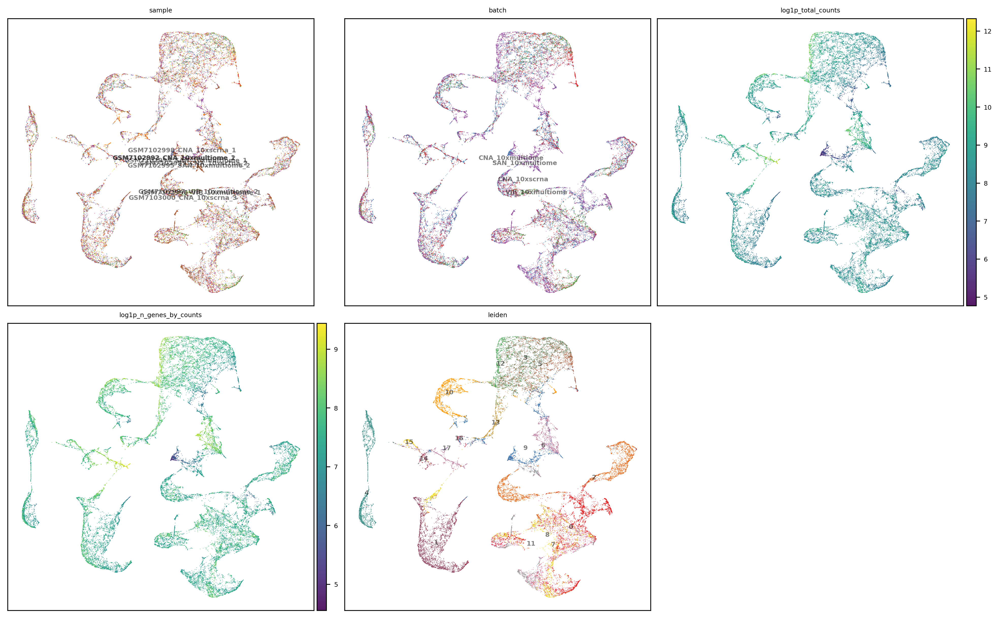

In [4]:
#ccd.ul.run_umap(adata, source_key=output_key, result_key=f'{output_key}_UMAP', n_components=2, n_neighbors=15, min_dist=0.1, metric='euclidean')
output_key = 'Concord'
show_cols = ['sample', 'batch', 'log1p_total_counts', 'log1p_n_genes_by_counts', 'leiden'] 
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,8), dpi=300, ncols=3,  font_size=6, point_size=1, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_basis}_{file_suffix}.png"
)

In [5]:
# identify shared cells between the two modalities
adata_atac = sc.read_h5ad(data_dir/"adata_fixedcells_consensus_processed_Jun07-1959.h5ad")

In [ ]:
adata_atac.obs['cell'] = adata_atac.obs.index.str.split("__").str[0]
adata.obs['cell'] = adata.obs.index.str.split("__").str[0]
adata_atac.obs

,Dupl_rate,FRIP,Scrublet_doublet_score,TSS_enrichment,Unique_nr_frag_in_regions,harmony_consensus_cell_type__mega,harmony_pycisTopic_leiden_10_3.0,seurat_cell_type_pred_score__mega,dataset,n_transcripts,n_transcripts_log1p,n_features,cell
CellID,,,,,,,,,,,,,
TCCTGAGCGAACGTCAGGGAACCGCG___OHS_s3atac_2.FIXEDCELLS,0.044105,0.061871,0.07645875251509054,4.531939,2053,Cytotoxic T cell,43,0.417394,OHS_s3atac_2.FIXEDCELLS,2732.0,7.913155,2097,TCCTGAGCGAACGTCAGGGAACCGCG
ACGCGACGACCGGAAGAAGCACGGAC___OHS_s3atac_2.FIXEDCELLS,0.046043,0.176452,0.04096170970614426,4.860000,1689,CD4+ T cell,20,0.342953,OHS_s3atac_2.FIXEDCELLS,1975.0,7.588830,868,ACGCGACGACCGGAAGAAGCACGGAC
GGTTAGTTCAAGTAGGACTATCGCAC___OHS_s3atac_2.FIXEDCELLS,0.052163,0.112198,0.06425041186161448,7.680000,1790,Natural killer cell,59,0.391198,OHS_s3atac_2.FIXEDCELLS,2502.0,7.825245,1748,GGTTAGTTCAAGTAGGACTATCGCAC
CTCTCTACTGAACGGCGTCTGCTTCC___OHS_s3atac_2.FIXEDCELLS,0.050187,0.203618,0.2592242194891202,4.567981,5842,Cytotoxic T cell,76,0.327305,OHS_s3atac_2.FIXEDCELLS,7003.0,8.854237,5629,CTCTCTACTGAACGGCGTCTGCTTCC
ATTGAGGAAATGATGCTCCTGCTTCC___OHS_s3atac_2.FIXEDCELLS,0.050402,0.213269,0.152276295133438,8.105000,1334,Natural killer cell,65,0.375826,OHS_s3atac_2.FIXEDCELLS,1608.0,7.383368,1172,ATTGAGGAAATGATGCTCCTGCTTCC
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTCTTAGACTTCTGAG___MDC_mtscatac_1.FIXEDCELLS,0.372840,0.137771,0.023001095290251915,7.160000,1660,CD4+ T cell,0,0.388897,MDC_mtscatac_1.FIXEDCELLS,5477.0,8.608496,1836,TTCTTAGACTTCTGAG
CATCAGAACCCGGACT___MDC_mtscatac_1.FIXEDCELLS,0.423152,0.126950,0.005975327679259831,1.745000,415,Cytotoxic T cell,43,0.432030,MDC_mtscatac_1.FIXEDCELLS,2608.0,7.866722,371,CATCAGAACCCGGACT
GAACCATACTACACTG___MDC_mtscatac_1.FIXEDCELLS,0.299508,0.435767,0.1592604605903341,6.030000,1116,Cytotoxic T cell,8,0.412242,MDC_mtscatac_1.FIXEDCELLS,1821.0,7.507690,1216,GAACCATACTACACTG


In [14]:
# Remove ".FIXEDCELLS" from the sample names in adata_atac
adata_atac.obs['sample'] = adata_atac.obs['dataset'].str.replace('.FIXEDCELLS', '', regex=False)
adata_atac.obs['sample'].value_counts()

sample
TXG_10xv2_2          9640
TXG_10xv11_1         9617
TXG_10xv2_1          9587
VIB_10xv1_2          7589
MDC_mtscatac_1       7236
BIO_ddseq_1          6148
MDC_mtscatac_2       5531
CNA_10xv2_2          5410
UCS_ddseq_1          5155
BIO_ddseq_2          5055
HAR_ddseq_2          4857
UCS_ddseq_2          4488
HAR_ddseq_1          4402
CNA_10xv11_3         4354
SAN_10xmultiome_2    3826
CNA_10xv2_1          3740
BRO_mtscatac_1       3413
CNA_10xmultiome_1    3224
BRO_mtscatac_2       3223
SAN_10xmultiome_1    3133
OHS_s3atac_1         3067
VIB_10xv2_2          3054
EPF_hydrop_1         2973
VIB_10xv2_1          2966
VIB_hydrop_2         2883
EPF_hydrop_2         2804
VIB_10xv1_1          2765
CNA_10xmultiome_2    2716
BIO_ddseq_3          2708
EPF_hydrop_4         2700
CNA_10xv11_2         2696
EPF_hydrop_3         2695
CNA_10xv11_1         2645
BIO_ddseq_4          2568
CNA_mtscatac_1       2524
VIB_hydrop_1         2438
CNA_hydrop_2         2092
VIB_10xmultiome_2    1919
OHS_s

In [54]:
# -------------------------------------------------------------------
# shared helpers & lookup tables (unchanged)
# -------------------------------------------------------------------
import pandas as pd, numpy as np

atac_wl = pd.read_csv(data_dir / "atac_737K-arc-v1.txt.gz", header=None, dtype=str)[0]
gex_wl  = pd.read_csv(data_dir / "gex_737K-arc-v1.txt.gz",  header=None, dtype=str)[0]

ATAC_SET, GEX_SET = set(atac_wl), set(gex_wl)
ATAC2GEX = dict(zip(atac_wl, gex_wl))
GEX2ATAC = dict(zip(gex_wl, atac_wl))

def guess_code_set(barcodes, n=500):
    """Return 'ATAC' or 'GEX' depending on which whitelist dominates the sample."""
    sample = barcodes[:n] if len(barcodes) > n else barcodes
    atac_hits = sum(b in ATAC_SET for b in sample)
    gex_hits  = sum(b in GEX_SET  for b in sample)
    return "ATAC" if atac_hits > gex_hits else "GEX"

# -------------------------------------------------------------------
# main per-sample pass
# -------------------------------------------------------------------
for sample in adata.obs["sample"].unique():
    if "multiome" not in sample:
        continue
    print(f"\n▶︎ processing sample: {sample}")

    # ---------- ATAC object ------------------------------------------------
    amask = adata_atac.obs["sample"] == sample
    abar  = adata_atac.obs.loc[amask, "cell"]

    code_atac = guess_code_set(abar.values)
    if code_atac == "ATAC":            # already ATAC-coded
        atac_barcode = abar
        gex_barcode  = abar.map(ATAC2GEX)
    else:                              # already GEX-coded
        gex_barcode  = abar
        atac_barcode = abar.map(GEX2ATAC)

    adata_atac.obs.loc[amask, "ATAC_barcode"] = atac_barcode.values
    adata_atac.obs.loc[amask, "GEX_barcode"]  = gex_barcode.values

    print(f"  ATAC: detected {code_atac}-code  "
          f"| filled GEX mates for {gex_barcode.notna().sum():,}/{len(abar):,} cells "
          f"| filled ATAC mates for {atac_barcode.notna().sum():,}")

    # ---------- RNA object -------------------------------------------------
    rmask = adata.obs["sample"] == sample
    rbar  = adata.obs.loc[rmask, "cell"]

    code_rna = guess_code_set(rbar.values)
    if code_rna == "GEX":              # already GEX-coded
        gex_barcode  = rbar
        atac_barcode = rbar.map(GEX2ATAC)
    else:                              # already ATAC-coded (rare)
        atac_barcode = rbar
        gex_barcode  = rbar.map(ATAC2GEX)

    adata.obs.loc[rmask, "GEX_barcode"]  = gex_barcode.values
    adata.obs.loc[rmask, "ATAC_barcode"] = atac_barcode.values

    print(f"   RNA: detected {code_rna}-code  "
          f"| filled ATAC mates for {atac_barcode.notna().sum():,}/{len(rbar):,} cells "
          f"| filled GEX mates for {gex_barcode.notna().sum():,}")



▶︎ processing sample: CNA_10xmultiome_1
  ATAC: detected GEX-code  | filled GEX mates for 3,224/3,224 cells | filled ATAC mates for 0
   RNA: detected GEX-code  | filled ATAC mates for 6,878/6,878 cells | filled GEX mates for 6,878

▶︎ processing sample: CNA_10xmultiome_2
  ATAC: detected GEX-code  | filled GEX mates for 2,716/2,716 cells | filled ATAC mates for 0
   RNA: detected GEX-code  | filled ATAC mates for 6,876/6,876 cells | filled GEX mates for 6,876

▶︎ processing sample: SAN_10xmultiome_1
  ATAC: detected ATAC-code  | filled GEX mates for 3,132/3,133 cells | filled ATAC mates for 3,133
   RNA: detected GEX-code  | filled ATAC mates for 3,598/3,598 cells | filled GEX mates for 3,598

▶︎ processing sample: SAN_10xmultiome_2
  ATAC: detected ATAC-code  | filled GEX mates for 3,826/3,826 cells | filled ATAC mates for 3,826
   RNA: detected GEX-code  | filled ATAC mates for 4,449/4,449 cells | filled GEX mates for 4,449

▶︎ processing sample: VIB_10xmultiome_1
  ATAC: detected 

In [57]:
# ---------------------------------------------------------------
# sanity‐check overlap between RNA and ATAC after barcode mapping
# ---------------------------------------------------------------
from collections import OrderedDict

report = []

for sample in sorted(set(adata.obs["sample"]) & set(adata_atac.obs["sample"])):
    if "multiome" not in sample:
        continue
    
    # ---- extract sets of barcodes per modality -----------------
    atac_mask = adata_atac.obs["sample"] == sample
    rna_mask  = adata.obs["sample"]       == sample
    
    atac_ATAC = set(adata_atac.obs.loc[atac_mask, "ATAC_barcode"].dropna())
    rna_ATAC  = set(adata.obs.loc[rna_mask,        "ATAC_barcode"].dropna())
    
    atac_GEX  = set(adata_atac.obs.loc[atac_mask, "GEX_barcode"].dropna())
    rna_GEX   = set(adata.obs.loc[rna_mask,        "GEX_barcode"].dropna())
    
    # ---- compute overlap stats ---------------------------------
    share_ATAC = len(atac_ATAC & rna_ATAC)
    share_GEX  = len(atac_GEX  & rna_GEX)
    
    rec = OrderedDict(
        sample         = sample,
        n_ATAC_atac    = len(atac_ATAC),
        n_ATAC_rna     = len(rna_ATAC),
        shared_ATAC    = share_ATAC,
        pct_ATAC       = 100 * share_ATAC / max(len(atac_ATAC), 1),
        n_GEX_atac     = len(atac_GEX),
        n_GEX_rna      = len(rna_GEX),
        shared_GEX     = share_GEX,
        pct_GEX        = 100 * share_GEX / max(len(atac_GEX), 1),
    )
    report.append(rec)

# ---- pretty print ---------------------------------------------
print("{:<20} {:>8} {:>8} {:>8} {:>6}   {:>8} {:>8} {:>8} {:>6}".format(
    "sample",
    "ATAC_A", "ATAC_R", "shared", "%",  "GEX_A", "GEX_R", "shared", "%"
))
for r in report:
    print("{sample:<20} {n_ATAC_atac:8} {n_ATAC_rna:8} {shared_ATAC:8} {pct_ATAC:6.1f}   "
          "{n_GEX_atac:8} {n_GEX_rna:8} {shared_GEX:8} {pct_GEX:6.1f}".format(**r))


sample                 ATAC_A   ATAC_R   shared      %      GEX_A    GEX_R   shared      %
CNA_10xmultiome_1           0     6878        0    0.0       3224     6878        0    0.0
CNA_10xmultiome_2           0     6876        0    0.0       2716     6876        0    0.0
SAN_10xmultiome_1        3133     3598     3012   96.1       3132     3598     3012   96.2
SAN_10xmultiome_2        3826     4449     3669   95.9       3826     4449     3669   95.9
VIB_10xmultiome_1           0     1356        0    0.0       1192     1356        0    0.0
VIB_10xmultiome_2           0     2262        0    0.0       1919     2262        0    0.0


In [73]:
# Load genotype txt file
import pandas as pd
genotype_res = pd.read_csv("../data/human_pbmc_atac_benchmark/genotype_concordance_unified.fixedcells_2_cistopic.txt", sep="\t")
# extract the technology, remove anything after 'FIXEDCELLS'
genotype_res['technology'] = genotype_res.index.str.replace(r'FIXEDCELLS.*', 'FIXEDCELLS', regex=True)
genotype_res['cell_name'] = genotype_res['BARCODE'] + "___" + genotype_res['technology']
# Check overlap between adata and genotype_res
overlap = adata_atac.obs_names.intersection(genotype_res['cell_name'])
print(f"Number of overlapping cells: {len(overlap)}")
# Assign called sample to adata.obs
adata_atac.obs['called_sample'] = np.nan
adata_atac.obs.loc[overlap, 'called_sample'] = genotype_res.set_index('cell_name').loc[overlap, 'sample'].values
adata_atac.obs['called_sample'].value_counts()

Number of overlapping cells: 107176


called_sample
sampleA    54256
sampleB    52920
Name: count, dtype: int64

In [77]:
# Leiden clustering on ATAC data based on CONCORD embedding
sc.pp.neighbors(adata_atac, use_rep='Concord', n_neighbors=15)
sc.tl.leiden(adata_atac, resolution=0.5, key_added='atac_leiden_concord')

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


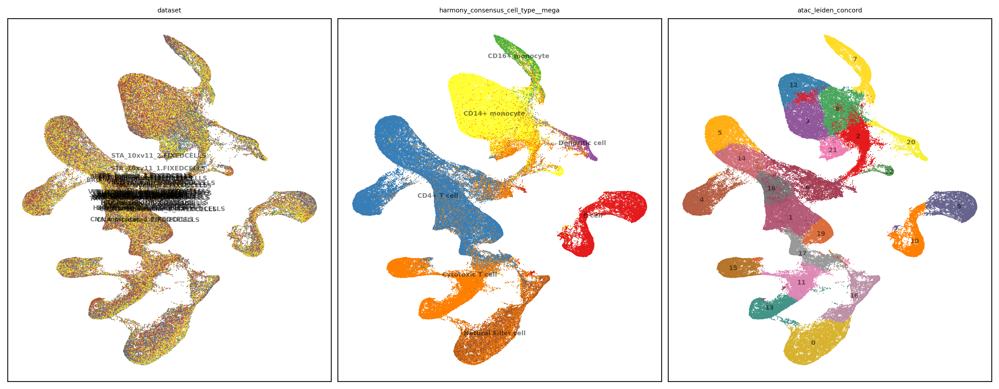

In [78]:
output_key = 'Concord'
show_basis = f'{output_key}_UMAP'
show_cols = ['dataset', 'harmony_consensus_cell_type__mega', 'atac_leiden_concord']   
ccd.pl.plot_embedding(
    adata_atac, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3,  font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"atac_shared_{show_basis}_{file_suffix}.png"
)

In [80]:
# get the shared barcodes but not NA
atac_shared = adata_atac[adata_atac.obs['ATAC_barcode'].notna()].copy()
atac_shared = atac_shared[atac_shared.obs['ATAC_barcode'].isin(adata.obs['ATAC_barcode'])].copy()
rna_shared = adata[adata.obs['ATAC_barcode'].notna()].copy()
rna_shared = rna_shared[rna_shared.obs['ATAC_barcode'].isin(adata_atac.obs['ATAC_barcode'])].copy()

print(f"Shared ATAC cells: {atac_shared.shape[0]:,}"
      f" | Shared RNA cells: {rna_shared.shape[0]:,}")

Shared ATAC cells: 6,770 | Shared RNA cells: 6,910


In [81]:
# transfer 'harmony_consensus_cell_type__mega' from atac_shared to rna_shared
atac_shared_obs = atac_shared.obs.copy()
atac_barcode_to_cell_type = atac_shared_obs.set_index('ATAC_barcode')['harmony_consensus_cell_type__mega'].to_dict()
rna_shared.obs['atac_harmony_consensus_cell_type__mega'] = rna_shared.obs['ATAC_barcode'].map(atac_barcode_to_cell_type)

# transfer 'called_sample' from atac_shared to rna_shared
atac_barcode_to_called_sample = atac_shared_obs.set_index('ATAC_barcode')['called_sample'].to_dict()
rna_shared.obs['atac_called_sample'] = rna_shared.obs['ATAC_barcode'].map(atac_barcode_to_called_sample)

# transfer 'atac_leiden_concord' from atac_shared to rna_shared
atac_barcode_to_atac_leiden = atac_shared_obs.set_index('ATAC_barcode')['atac_leiden_concord'].to_dict()
rna_shared.obs['atac_leiden_concord'] = rna_shared.obs['ATAC_barcode'].map(atac_barcode_to_atac_leiden)


In [86]:
# Transfer 'atac_harmony_consensus_cell_type__mega', 'atac_called_sample', and 'atac_leiden_concord' from rna_shared to adata, based on the index
adata.obs.loc[rna_shared.obs_names, 'atac_harmony_consensus_cell_type__mega'] = rna_shared.obs['atac_harmony_consensus_cell_type__mega'].values
adata.obs.loc[rna_shared.obs_names, 'atac_called_sample'] = rna_shared.obs['atac_called_sample'].values
adata.obs.loc[rna_shared.obs_names, 'atac_leiden_concord'] = rna_shared.obs['atac_leiden_concord'].values


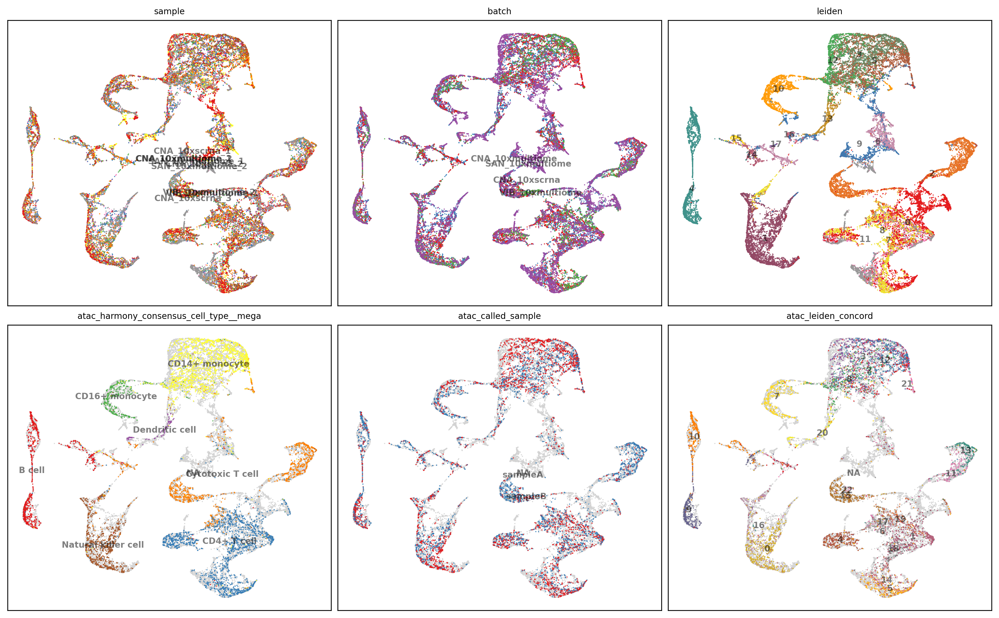

In [87]:
output_key = 'Concord'
show_cols = ['sample', 'batch', 'leiden', 'atac_harmony_consensus_cell_type__mega', 'atac_called_sample', 'atac_leiden_concord']
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,8), dpi=300, ncols=3,  font_size=8, point_size=5, legend_loc='on data',
    save_path=save_dir / f"adata_embeddings_{show_basis}_{file_suffix}.png"
)

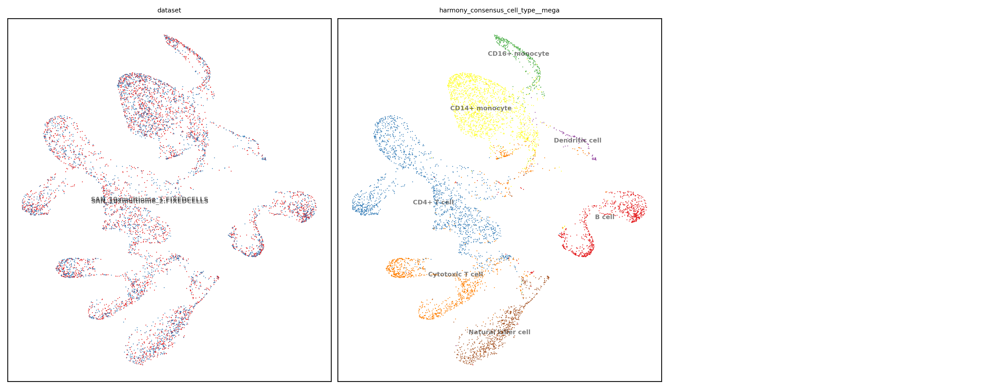

In [68]:
output_key = 'Concord'
show_basis = f'{output_key}_UMAP'
show_cols = ['dataset', 'harmony_consensus_cell_type__mega']   
ccd.pl.plot_embedding(
    atac_shared, show_basis, show_cols, figsize=(13,5), dpi=300, ncols=3,  font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"atac_shared_{show_basis}_{file_suffix}.png"
)

In [98]:
# save adata
adata.write_h5ad(data_dir / f"adata_concord_processed_{file_suffix}.h5ad")
print(f"Saved adata to {data_dir / f'adata_concord_processed_{file_suffix}.h5ad'}")

Saved adata to ../data/human_pbmc_atac_benchmark/adata_concord_processed_Jun19-1920.h5ad


In [100]:
# save adata_atac
adata_atac.write_h5ad(data_dir / f"adata_atac_concord_processed_{file_suffix}.h5ad")
print(f"Saved adata_atac to {data_dir / f'adata_atac_concord_processed_{file_suffix}.h5ad'}")

Saved adata_atac to ../data/human_pbmc_atac_benchmark/adata_atac_concord_processed_Jun19-1920.h5ad


In [93]:

adata_copy = adata.copy()
adata_copy.var["gene_name"] = adata_copy.var["gene_name"].astype(str)
adata_copy.var_names = adata_copy.var["gene_name"]
adata_copy.var_names_make_unique()

In [99]:
# Convert 
ccd.ul.anndata_to_viscello(adata_copy, data_dir / f"cello_concord_processed_{proj_name}_{file_suffix}", project_name = proj_name, organism='hsa')
print(f"Saved viscello to {data_dir / f'cello_concord_processed_{proj_name}_{file_suffix}'}")


VisCello project created at ../data/human_pbmc_atac_benchmark/cello_concord_processed_pbmc_atac_scRNAmultiome_Jun19-1920
Saved viscello to ../data/human_pbmc_atac_benchmark/cello_concord_processed_pbmc_atac_scRNAmultiome_Jun19-1920
